In [ ]:
from sklearn.base import BaseEstimator, ClassifierMixin
import numpy as np
import matplotlib.pyplot as plt
import time
from sklearn.decomposition import PCA
from scipy.interpolate import griddata
import matplotlib.gridspec as gridspec

def dist(X, C):
  X = np.atleast_2d(X)
  C = np.atleast_2d(C)

  mat = np.zeros((X.shape[0], C.shape[0]))
  for i in range(X.shape[0]):
    for j in range(C.shape[0]):
      mat[i][j] = np.sqrt(np.dot((X[i,:] - C[j,:]),(X[i,:] - C[j,:]).T))
  return mat

def dist_sigma(X, C, sigma_value=1):
  X = np.atleast_2d(X)
  C = np.atleast_2d(C)

  mat = np.zeros((X.shape[0], C.shape[0]))
  for i in range(X.shape[0]):
    for j in range(C.shape[0]):
      mat[i][j] = np.dot((X[i,:] - C[j,:]),(X[i,:] - C[j,:]).T)

  mat = np.exp(-mat/np.power(sigma_value, 2))
  return mat

In [ ]:
class SimplePerceptron(BaseEstimator, ClassifierMixin):
  def __init__(self, learning_rate=0.1):
    self.learning_rate = learning_rate
    self.non_linear = None
    self.use_sigma = None
    self.sigma_value = None
    self.C_ = None

  def fit(self, X, y, k_centers=55, k_max=2500, non_linear=False, use_sigma=False, sigma_value=0.1):
    self.non_linear = non_linear
    self.use_sigma = use_sigma
    self.sigma_value = sigma_value

    if self.non_linear:
      #losowanie indeksów centrów, bez powtórek, lockuję centra żeby pomiary byly miarodajne
      np.random.seed(42)
      indices = np.random.choice(X.shape[0], k_centers, replace=False)
      self.C_ = X[indices]

      if self.use_sigma:
        X = dist_sigma(X, self.C_, self.sigma_value)
      else:
        X = dist(X, self.C_)

      #print(X.shape)

    self.classes_ = np.unique(y) #binarny -1 to 0, 1 to 1 w kontekście etykiet
    m, n = X.shape
    yy = np.ones(m, dtype=np.int8)
    yy[y == self.classes_[0]] = -1
    self.w_ = np.zeros(n + 1)
    self.k_ = 0
    X_ext = np.hstack((np.ones((m, 1)), X))

    while True:
      E = []
      E = np.where(self.w_.dot(X_ext.T) * yy <= 0.0)[0]
      if len(E) == 0:
        break
      i = np.random.choice(E)
      self.w_ = self.w_ + self.learning_rate * yy[i] * X_ext[i] #wzór na poprawkę
      self.k_ += 1
      #warunek stopu
      if self.k_ >= k_max:
        break
    return X, self.C_ #czyli teraz tak, jeśli wezmę non_linear to zwracam X w tylu wymiarach ile jest środków, ale środki pozostają w starym wymiarze

  def predict(self, X):
    return self.classes_[1 * (self.decision_function(X) > 0.0)] #żeby było legalnie
  def decision_function(self, X):
    if self.non_linear:  # w przypadku w którym jest nieliniowo, musimy sprowadzić dane z X do tej samej postaci co dane uczące

      if self.use_sigma:
        X = dist_sigma(X, self.C_, self.sigma_value)
      else:
        X = dist(X, self.C_)

    m =  X.shape[0]
    X_ext = np.hstack((np.ones((m, 1)), X))
    return self.w_.dot(X_ext.T)

In [ ]:
def fake_data(m):
  X = np.zeros((m, 2))
  m_half = m // 2 #umawiamy się że m jest parzyste
  X[:, 0] = np.random.rand(m)
  X[:m_half, 1] = np.random.rand(m_half) * 0.4999
  X[m_half:, 1] = np.random.rand(m_half) * 0.4999 + 0.5001
  y = np.ones(m, dtype=np.int8)
  y[m_half:] = -1
  return X, y


def data_sinus(m):
  X = np.zeros((m, 2))
  y = np.ones(m, dtype=np.int8)
  for index, _ in enumerate(X):
    X[index, 0] = np.random.uniform(0, 2 * np.pi)
    X[index, 1] = np.random.uniform(-1, 1)
    y[index] =  -1 if np.abs(np.sin(X[index, 0])) > np.abs(X[index, 1]) else 1
  #normalizacja
  X = 2 * (X - np.min(X, axis=0)) / (np.max(X, axis=0) - np.min(X, axis=0)) - 1
  return X, y

FIT TIME: 0.1073458194732666 s
clf.w_: [ 5.60000000e+00  7.37231425e-03 -1.12212184e+01]
k: 317
ACC: 1.0


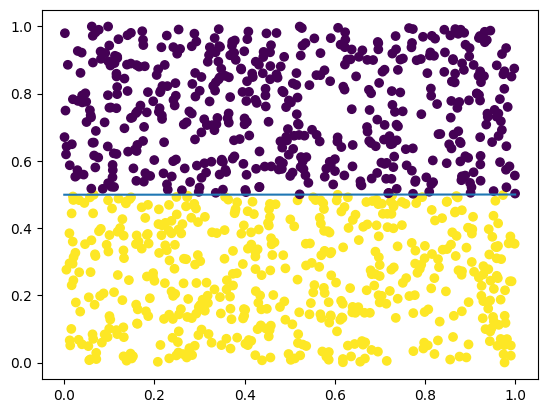

In [ ]:
##część z zajęć
np.random.seed(0)
X, y = fake_data(m=1000)
clf = SimplePerceptron(learning_rate=0.8)
t1 = time.time()
clf.fit(X, y)
t2 = time.time()
print(f"FIT TIME: {t2 - t1} s")
print(f"clf.w_: {clf.w_}")
print(f"k: {clf.k_}")
print(f"ACC: {clf.score(X, y)}")
x1 = np.array([0.0, 1.0])
x2 = -(clf.w_[0] + clf.w_[1] * x1) / clf.w_[2]
plt.scatter(X[:, 0], X[:, 1], c=y)
plt.plot(x1, x2)
plt.show()

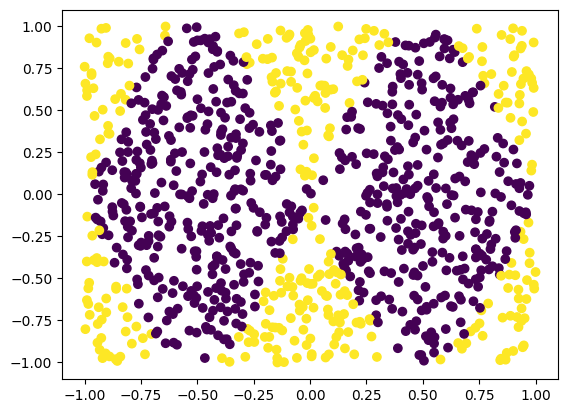

FIT TIME: 0.1374797821044922 s
ACC: 0.676
FIT TIME: 0.15710043907165527 s
ACC: 0.381
FIT TIME: 0.17255759239196777 s
ACC: 0.711
FIT TIME: 0.1697089672088623 s
ACC: 0.691
FIT TIME: 0.15951943397521973 s
ACC: 0.463
FIT TIME: 0.16008305549621582 s
ACC: 0.524
FIT TIME: 0.243424654006958 s
ACC: 0.825
FIT TIME: 0.2817068099975586 s
ACC: 0.828
FIT TIME: 0.15584182739257812 s
ACC: 0.837
FIT TIME: 0.1596531867980957 s
ACC: 0.754
Best params: [8.37e-01 2.00e+01 5.00e+02 2.00e-01]


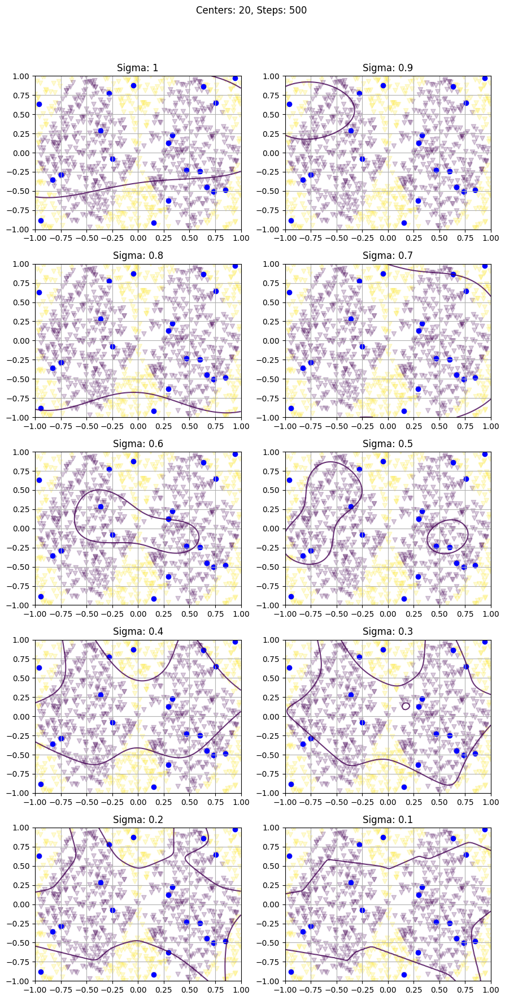

FIT TIME: 0.40701770782470703 s
ACC: 0.718
FIT TIME: 0.25287604331970215 s
ACC: 0.333
FIT TIME: 0.286104679107666 s
ACC: 0.514
FIT TIME: 0.3978142738342285 s
ACC: 0.78
FIT TIME: 0.41832828521728516 s
ACC: 0.755
FIT TIME: 0.2597475051879883 s
ACC: 0.787
FIT TIME: 0.27295923233032227 s
ACC: 0.841
FIT TIME: 0.22610974311828613 s
ACC: 0.892
FIT TIME: 0.2210075855255127 s
ACC: 0.821
FIT TIME: 0.2260425090789795 s
ACC: 0.74
Best params: [8.92e-01 2.00e+01 1.50e+03 3.00e-01]


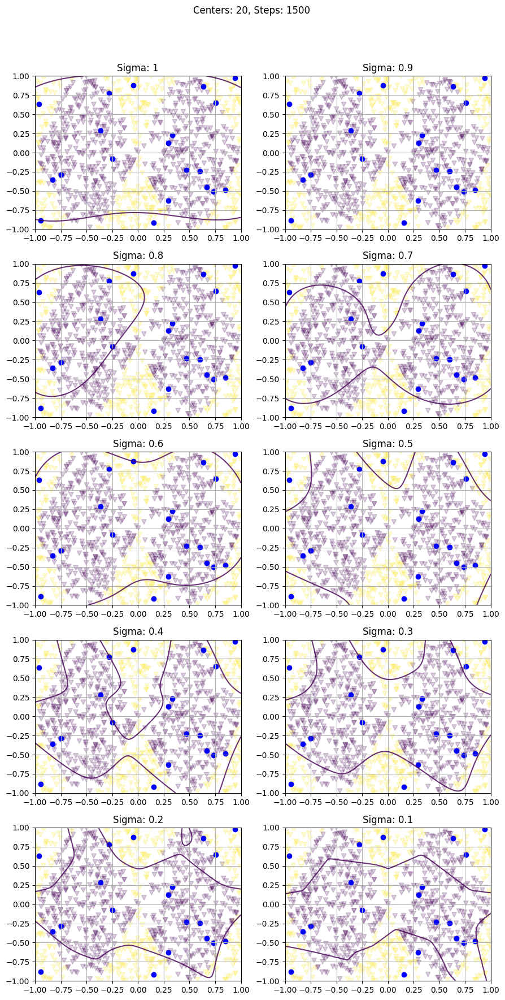

FIT TIME: 0.7681369781494141 s
ACC: 0.726
FIT TIME: 0.6612722873687744 s
ACC: 0.55
FIT TIME: 0.2943136692047119 s
ACC: 0.687
FIT TIME: 0.2878859043121338 s
ACC: 0.766
FIT TIME: 0.29433679580688477 s
ACC: 0.817
FIT TIME: 0.2846202850341797 s
ACC: 0.727
FIT TIME: 0.2734096050262451 s
ACC: 0.901
FIT TIME: 0.30544018745422363 s
ACC: 0.757
FIT TIME: 0.2805948257446289 s
ACC: 0.865
FIT TIME: 0.6455485820770264 s
ACC: 0.78
Best params: [9.01e-01 2.00e+01 2.50e+03 4.00e-01]


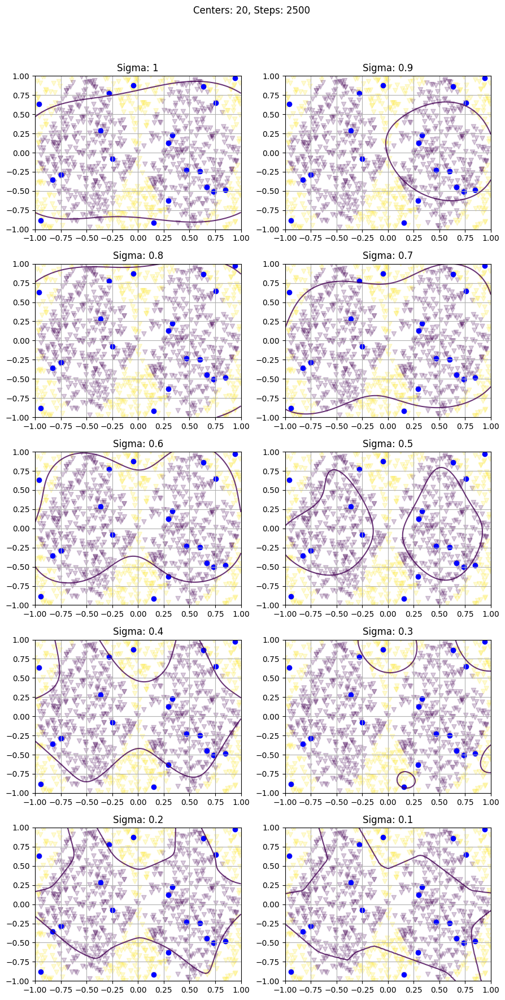

FIT TIME: 0.5423874855041504 s
ACC: 0.731
FIT TIME: 0.3491642475128174 s
ACC: 0.456
FIT TIME: 0.38716888427734375 s
ACC: 0.72
FIT TIME: 0.36745381355285645 s
ACC: 0.731
FIT TIME: 0.4727346897125244 s
ACC: 0.838
FIT TIME: 0.7378356456756592 s
ACC: 0.876
FIT TIME: 0.8219819068908691 s
ACC: 0.848
FIT TIME: 0.340712308883667 s
ACC: 0.898
FIT TIME: 0.33948826789855957 s
ACC: 0.865
FIT TIME: 0.3484318256378174 s
ACC: 0.775
Best params: [8.98e-01 2.00e+01 3.50e+03 3.00e-01]


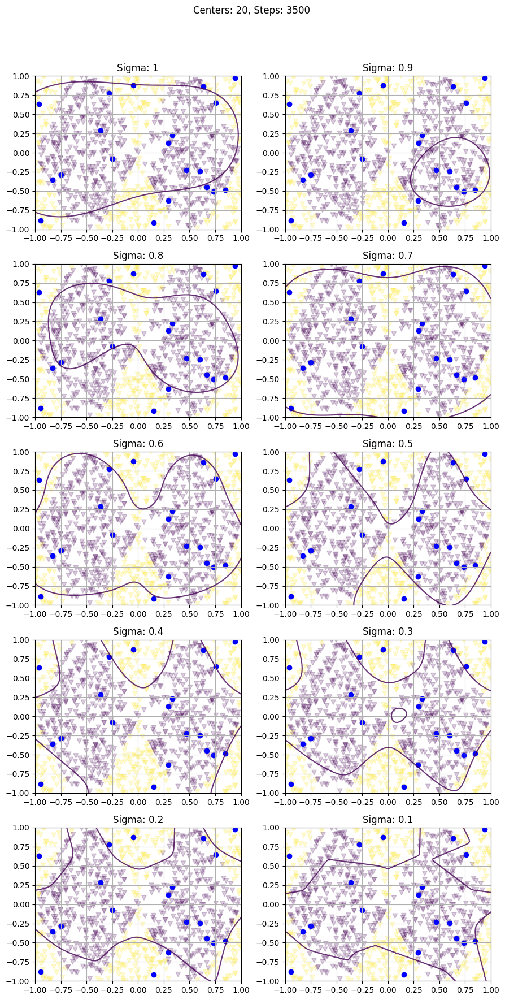

FIT TIME: 0.7376840114593506 s
ACC: 0.745
FIT TIME: 0.6460363864898682 s
ACC: 0.696
FIT TIME: 1.1382520198822021 s
ACC: 0.471
FIT TIME: 0.4498775005340576 s
ACC: 0.708
FIT TIME: 0.4454019069671631 s
ACC: 0.74
FIT TIME: 0.4548039436340332 s
ACC: 0.893
FIT TIME: 0.4430735111236572 s
ACC: 0.877
FIT TIME: 0.46559929847717285 s
ACC: 0.917
FIT TIME: 0.42430996894836426 s
ACC: 0.871
FIT TIME: 0.7891607284545898 s
ACC: 0.796
Best params: [9.17e-01 2.00e+01 5.00e+03 3.00e-01]


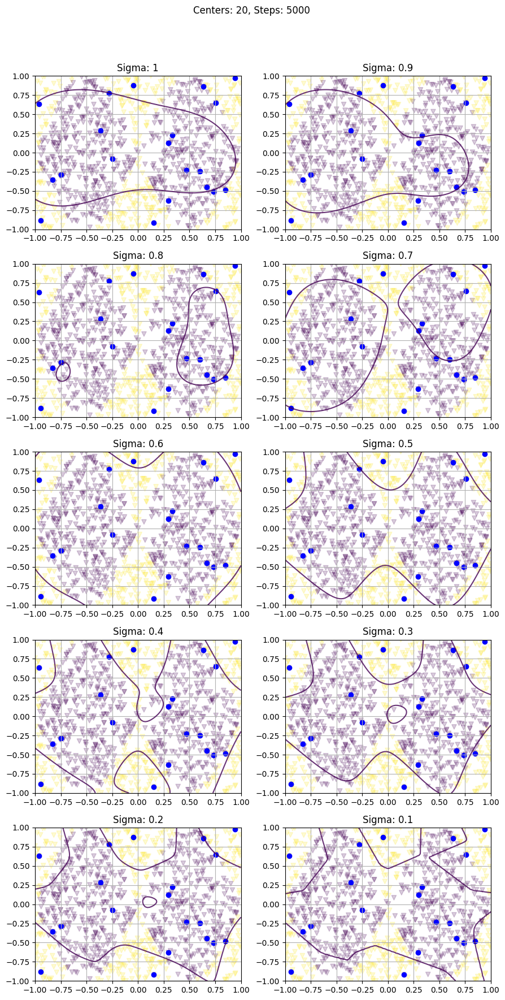

FIT TIME: 0.42299365997314453 s
ACC: 0.333
FIT TIME: 0.2894320487976074 s
ACC: 0.595
FIT TIME: 0.2544865608215332 s
ACC: 0.692
FIT TIME: 0.25597095489501953 s
ACC: 0.57
FIT TIME: 0.4396095275878906 s
ACC: 0.676
FIT TIME: 0.3343219757080078 s
ACC: 0.789
FIT TIME: 0.24337315559387207 s
ACC: 0.84
FIT TIME: 0.2455301284790039 s
ACC: 0.901
FIT TIME: 0.2701714038848877 s
ACC: 0.867
FIT TIME: 0.4082760810852051 s
ACC: 0.8
Best params: [9.01e-01 4.00e+01 5.00e+02 3.00e-01]


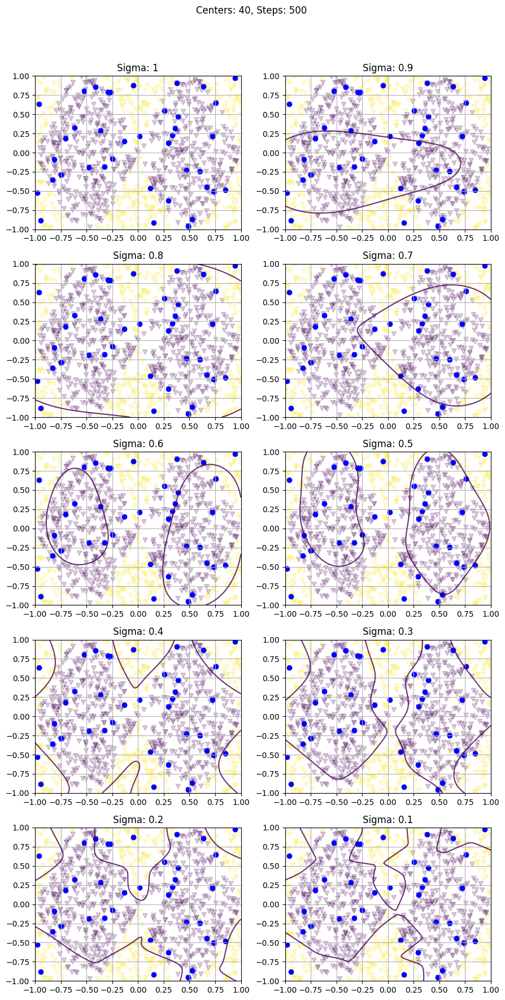

FIT TIME: 0.5673267841339111 s
ACC: 0.731
FIT TIME: 0.3043045997619629 s
ACC: 0.74
FIT TIME: 0.6201004981994629 s
ACC: 0.703
FIT TIME: 0.31482934951782227 s
ACC: 0.792
FIT TIME: 0.3509640693664551 s
ACC: 0.857
FIT TIME: 0.30228281021118164 s
ACC: 0.889
FIT TIME: 0.33910512924194336 s
ACC: 0.898
FIT TIME: 0.45506930351257324 s
ACC: 0.828
FIT TIME: 0.2502734661102295 s
ACC: 0.877
FIT TIME: 0.39658522605895996 s
ACC: 0.819
Best params: [8.98e-01 4.00e+01 1.50e+03 4.00e-01]


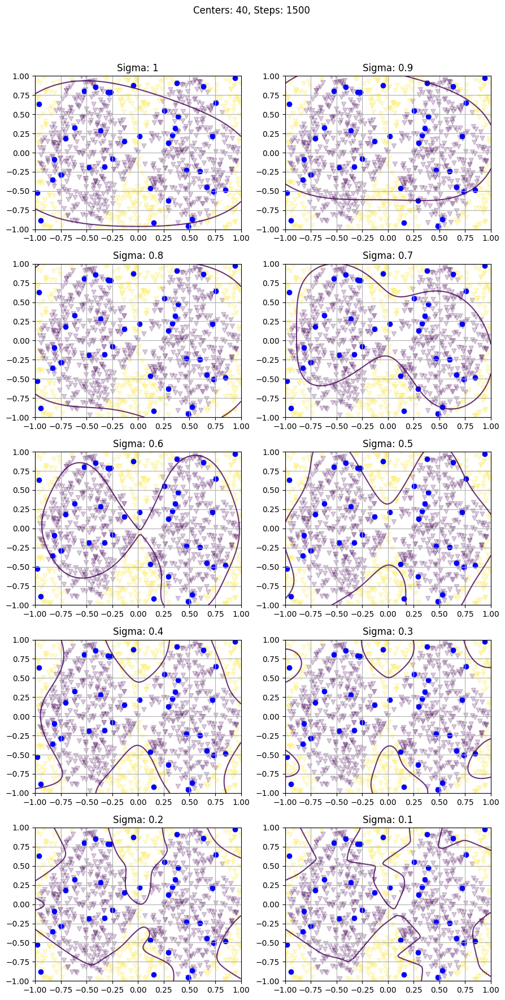

FIT TIME: 0.5894792079925537 s
ACC: 0.713
FIT TIME: 0.8021142482757568 s
ACC: 0.538
FIT TIME: 0.4272165298461914 s
ACC: 0.789
FIT TIME: 0.38269901275634766 s
ACC: 0.715
FIT TIME: 0.4062325954437256 s
ACC: 0.835
FIT TIME: 0.36678194999694824 s
ACC: 0.799
FIT TIME: 0.6387410163879395 s
ACC: 0.953
FIT TIME: 0.3787658214569092 s
ACC: 0.939
FIT TIME: 0.3611104488372803 s
ACC: 0.893
FIT TIME: 0.4274897575378418 s
ACC: 0.826
Best params: [9.53e-01 4.00e+01 2.50e+03 4.00e-01]


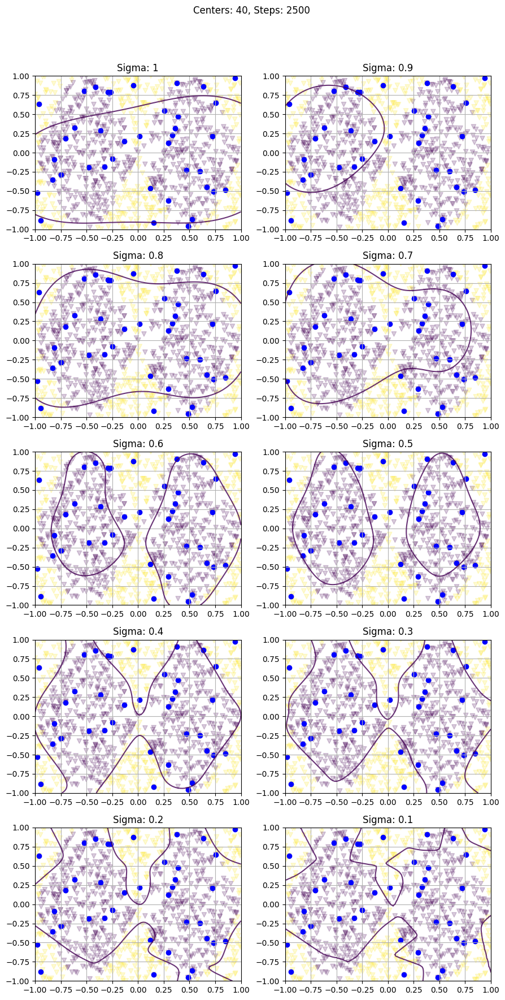

FIT TIME: 0.6791589260101318 s
ACC: 0.483
FIT TIME: 0.5073223114013672 s
ACC: 0.723
FIT TIME: 0.447268009185791 s
ACC: 0.764
FIT TIME: 0.48578548431396484 s
ACC: 0.824
FIT TIME: 0.8911123275756836 s
ACC: 0.846
FIT TIME: 0.4481480121612549 s
ACC: 0.956
FIT TIME: 0.44735026359558105 s
ACC: 0.904
FIT TIME: 0.4717686176300049 s
ACC: 0.921
FIT TIME: 0.5654363632202148 s
ACC: 0.904
FIT TIME: 0.8919720649719238 s
ACC: 0.826
Best params: [9.56e-01 4.00e+01 3.50e+03 5.00e-01]


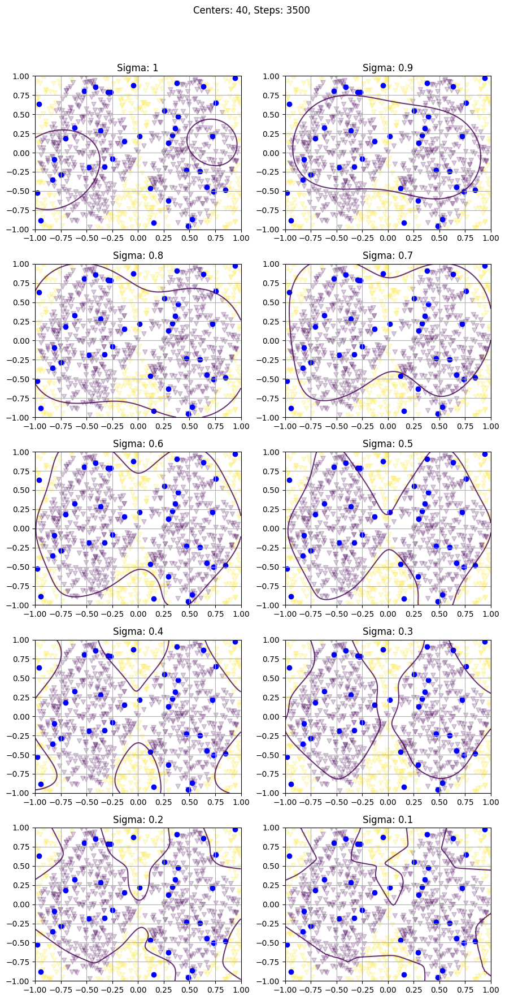

FIT TIME: 0.939760684967041 s
ACC: 0.742
FIT TIME: 0.5944128036499023 s
ACC: 0.773
FIT TIME: 1.3939440250396729 s
ACC: 0.798
FIT TIME: 0.5809657573699951 s
ACC: 0.783
FIT TIME: 0.5369811058044434 s
ACC: 0.898
FIT TIME: 0.5305099487304688 s
ACC: 0.921
FIT TIME: 1.0937976837158203 s
ACC: 0.956
FIT TIME: 0.5272939205169678 s
ACC: 0.936
FIT TIME: 0.5498049259185791 s
ACC: 0.916
FIT TIME: 0.5321886539459229 s
ACC: 0.821
Best params: [9.56e-01 4.00e+01 5.00e+03 4.00e-01]


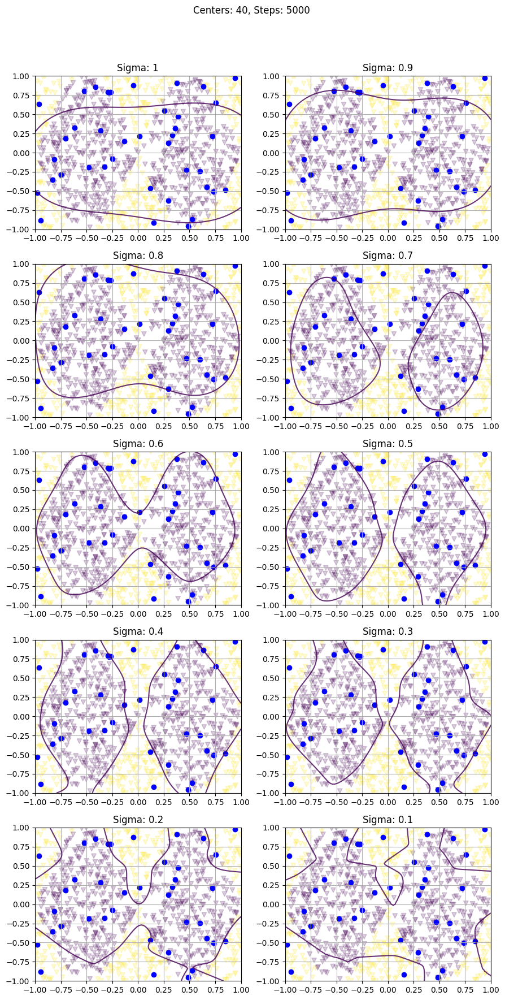

FIT TIME: 0.6303753852844238 s
ACC: 0.622
FIT TIME: 0.34067201614379883 s
ACC: 0.514
FIT TIME: 0.32064104080200195 s
ACC: 0.702
FIT TIME: 0.337047815322876 s
ACC: 0.759
FIT TIME: 0.32822513580322266 s
ACC: 0.814
FIT TIME: 0.31847167015075684 s
ACC: 0.875
FIT TIME: 0.35378193855285645 s
ACC: 0.94
FIT TIME: 0.567471981048584 s
ACC: 0.917
FIT TIME: 0.33056187629699707 s
ACC: 0.891
FIT TIME: 0.35329270362854004 s
ACC: 0.866
Best params: [9.4e-01 6.0e+01 5.0e+02 4.0e-01]


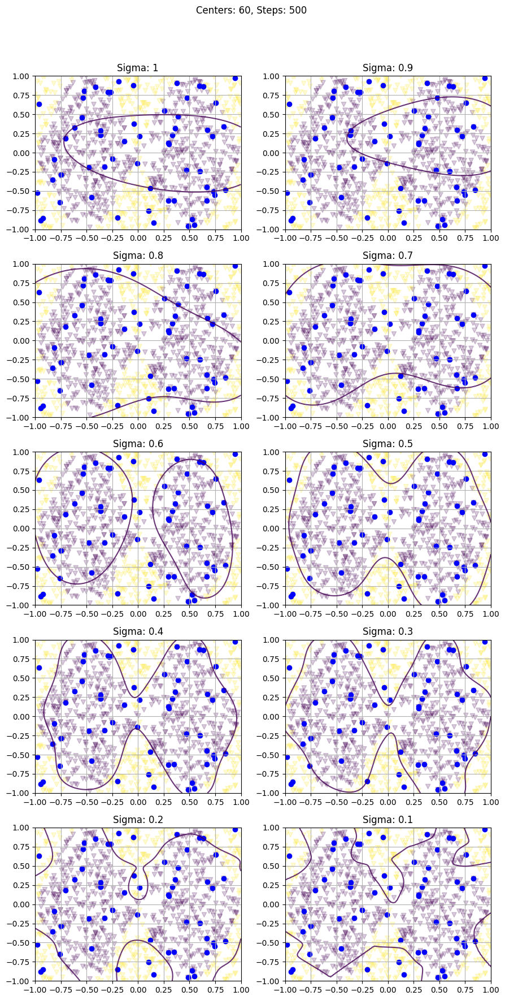

FIT TIME: 0.7085714340209961 s
ACC: 0.679
FIT TIME: 0.4429008960723877 s
ACC: 0.701
FIT TIME: 0.4045553207397461 s
ACC: 0.772
FIT TIME: 0.599215030670166 s
ACC: 0.812
FIT TIME: 0.4062514305114746 s
ACC: 0.838
FIT TIME: 0.38979458808898926 s
ACC: 0.925
FIT TIME: 0.3858034610748291 s
ACC: 0.934
FIT TIME: 0.6256883144378662 s
ACC: 0.948
FIT TIME: 0.39258360862731934 s
ACC: 0.932
FIT TIME: 0.43938779830932617 s
ACC: 0.862
Best params: [9.48e-01 6.00e+01 1.50e+03 3.00e-01]


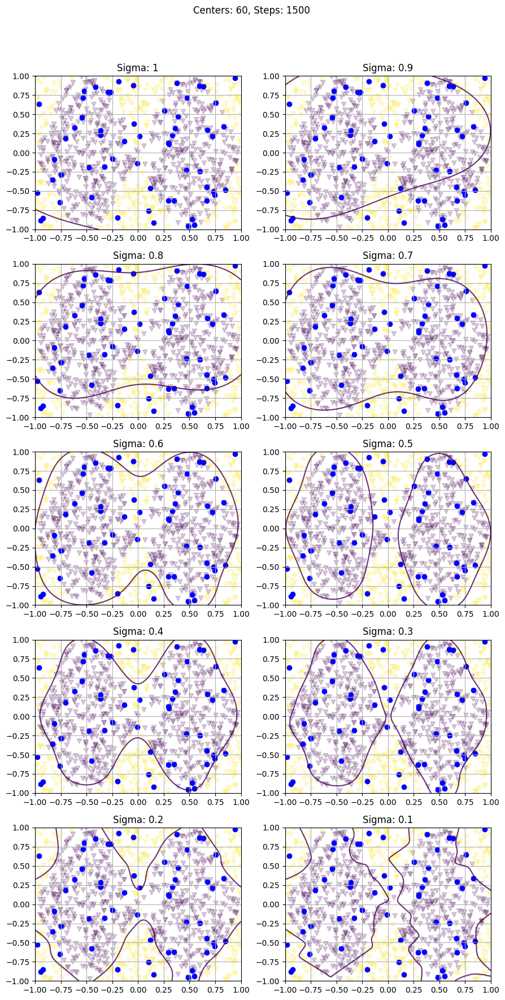

FIT TIME: 0.6309912204742432 s
ACC: 0.735
FIT TIME: 0.4804062843322754 s
ACC: 0.744
FIT TIME: 0.4771230220794678 s
ACC: 0.793
FIT TIME: 0.49623703956604004 s
ACC: 0.821
FIT TIME: 0.4613473415374756 s
ACC: 0.814
FIT TIME: 0.5207090377807617 s
ACC: 0.891
FIT TIME: 0.8344063758850098 s
ACC: 0.951
FIT TIME: 0.5175807476043701 s
ACC: 0.964
FIT TIME: 0.5581910610198975 s
ACC: 0.869
FIT TIME: 1.005626916885376 s
ACC: 0.894
Best params: [9.64e-01 6.00e+01 2.50e+03 3.00e-01]


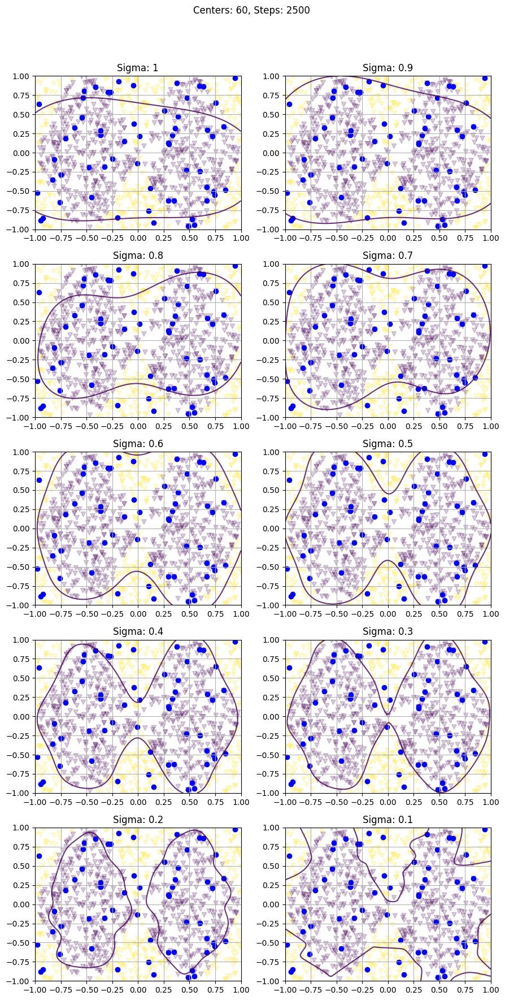

FIT TIME: 0.959111213684082 s
ACC: 0.395
FIT TIME: 0.5983951091766357 s
ACC: 0.769
FIT TIME: 0.6150269508361816 s
ACC: 0.606
FIT TIME: 0.540475606918335 s
ACC: 0.803
FIT TIME: 0.5422556400299072 s
ACC: 0.895
FIT TIME: 0.6703572273254395 s
ACC: 0.88
FIT TIME: 0.5700085163116455 s
ACC: 0.943
FIT TIME: 0.5389342308044434 s
ACC: 0.966
FIT TIME: 1.2144625186920166 s
ACC: 0.942
FIT TIME: 0.5507075786590576 s
ACC: 0.893
Best params: [9.66e-01 6.00e+01 3.50e+03 3.00e-01]


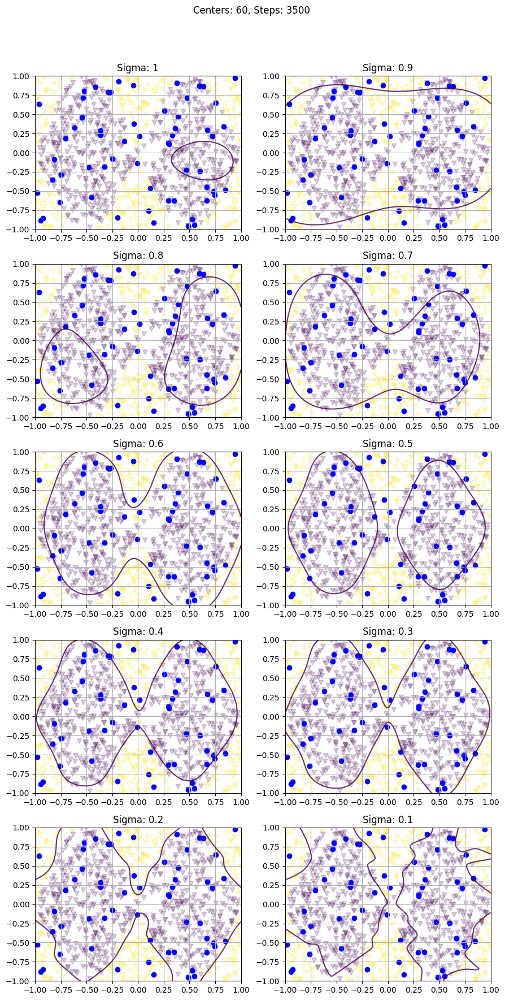

FIT TIME: 1.5807814598083496 s
ACC: 0.736
FIT TIME: 0.752234935760498 s
ACC: 0.735
FIT TIME: 0.6783077716827393 s
ACC: 0.737
FIT TIME: 0.6465554237365723 s
ACC: 0.798
FIT TIME: 0.6556146144866943 s
ACC: 0.898
FIT TIME: 0.6415770053863525 s
ACC: 0.945
FIT TIME: 0.6961674690246582 s
ACC: 0.949
FIT TIME: 0.6363847255706787 s
ACC: 0.954
FIT TIME: 0.6562669277191162 s
ACC: 0.959
FIT TIME: 0.6795287132263184 s
ACC: 0.9
Best params: [9.59e-01 6.00e+01 5.00e+03 2.00e-01]


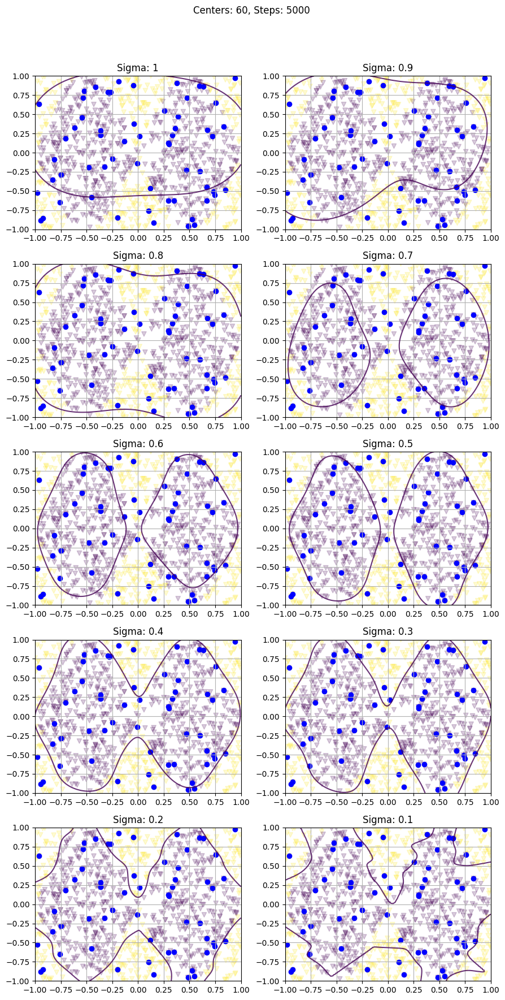

FIT TIME: 0.7598052024841309 s
ACC: 0.709
FIT TIME: 0.42210865020751953 s
ACC: 0.697
FIT TIME: 0.4067227840423584 s
ACC: 0.746
FIT TIME: 0.4700939655303955 s
ACC: 0.7
FIT TIME: 0.47669124603271484 s
ACC: 0.779
FIT TIME: 0.41747212409973145 s
ACC: 0.837
FIT TIME: 0.42533349990844727 s
ACC: 0.898
FIT TIME: 0.6406326293945312 s
ACC: 0.943
FIT TIME: 0.437000036239624 s
ACC: 0.866
FIT TIME: 0.4050593376159668 s
ACC: 0.889
Best params: [9.43e-01 8.00e+01 5.00e+02 3.00e-01]


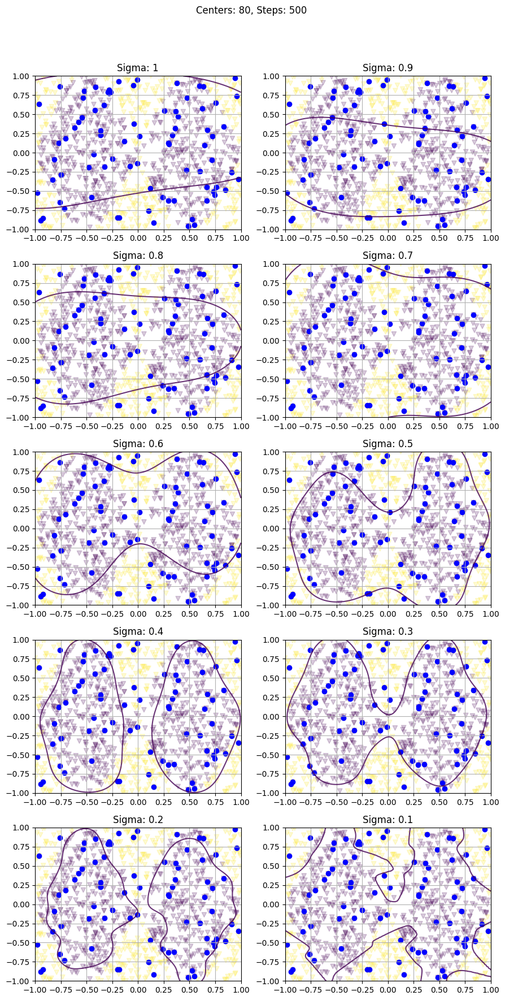

FIT TIME: 0.8555634021759033 s
ACC: 0.722
FIT TIME: 0.5039100646972656 s
ACC: 0.463
FIT TIME: 0.5524256229400635 s
ACC: 0.774
FIT TIME: 0.5357673168182373 s
ACC: 0.729
FIT TIME: 0.9212071895599365 s
ACC: 0.817
FIT TIME: 0.5890965461730957 s
ACC: 0.916
FIT TIME: 0.4912595748901367 s
ACC: 0.95
FIT TIME: 0.527733325958252 s
ACC: 0.965
FIT TIME: 0.47927284240722656 s
ACC: 0.919
FIT TIME: 0.5254867076873779 s
ACC: 0.895
Best params: [9.65e-01 8.00e+01 1.50e+03 3.00e-01]


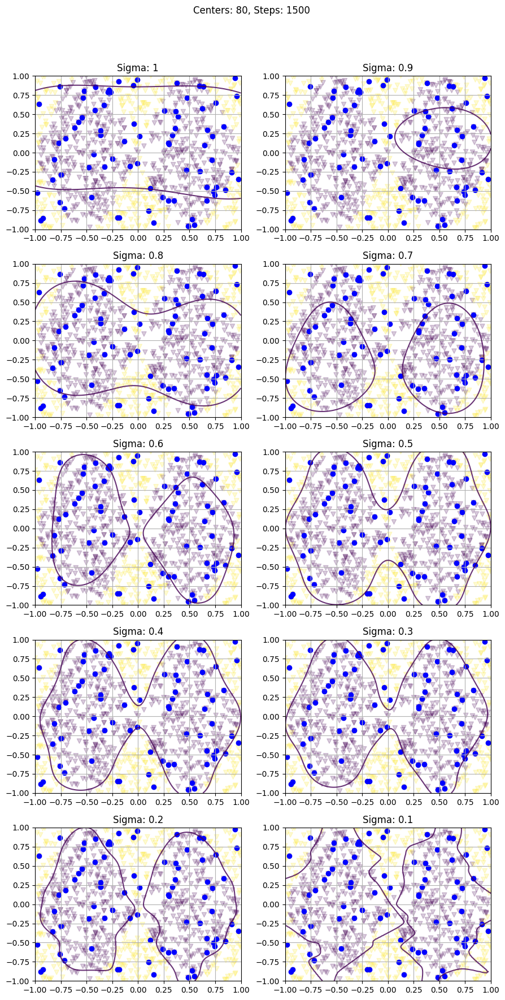

FIT TIME: 0.9081358909606934 s
ACC: 0.757
FIT TIME: 1.1758050918579102 s
ACC: 0.718
FIT TIME: 0.5877640247344971 s
ACC: 0.76
FIT TIME: 0.6455070972442627 s
ACC: 0.837
FIT TIME: 0.778388500213623 s
ACC: 0.735
FIT TIME: 0.595390796661377 s
ACC: 0.892
FIT TIME: 0.8364267349243164 s
ACC: 0.931
FIT TIME: 0.5946042537689209 s
ACC: 0.976
FIT TIME: 0.6193199157714844 s
ACC: 0.943
FIT TIME: 1.084648609161377 s
ACC: 0.899
Best params: [9.76e-01 8.00e+01 2.50e+03 3.00e-01]


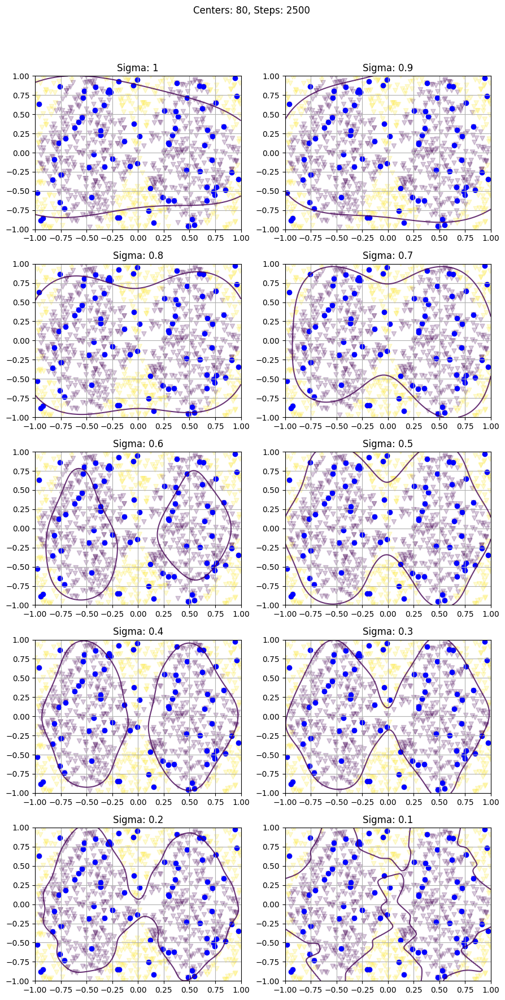

FIT TIME: 1.0647501945495605 s
ACC: 0.562
FIT TIME: 0.6882312297821045 s
ACC: 0.762
FIT TIME: 0.6442852020263672 s
ACC: 0.722
FIT TIME: 1.4048542976379395 s
ACC: 0.889
FIT TIME: 0.690908670425415 s
ACC: 0.908
FIT TIME: 0.6511602401733398 s
ACC: 0.927
FIT TIME: 0.6517894268035889 s
ACC: 0.931
FIT TIME: 0.6226770877838135 s
ACC: 0.967
FIT TIME: 1.2677054405212402 s
ACC: 0.957
FIT TIME: 0.6685957908630371 s
ACC: 0.89
Best params: [9.67e-01 8.00e+01 3.50e+03 3.00e-01]


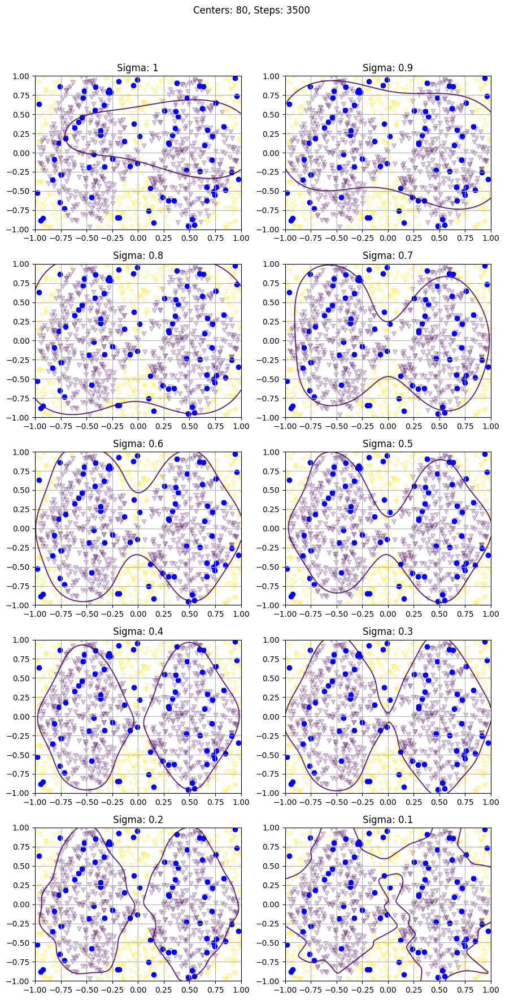

FIT TIME: 1.6622908115386963 s
ACC: 0.735
FIT TIME: 0.8108687400817871 s
ACC: 0.746
FIT TIME: 0.8297958374023438 s
ACC: 0.567
FIT TIME: 0.837620735168457 s
ACC: 0.804
FIT TIME: 0.8293230533599854 s
ACC: 0.921
FIT TIME: 1.9621622562408447 s
ACC: 0.939
FIT TIME: 0.8249392509460449 s
ACC: 0.966
FIT TIME: 0.8133251667022705 s
ACC: 0.98
FIT TIME: 0.8497281074523926 s
ACC: 0.976
FIT TIME: 0.8447933197021484 s
ACC: 0.902
Best params: [9.8e-01 8.0e+01 5.0e+03 3.0e-01]


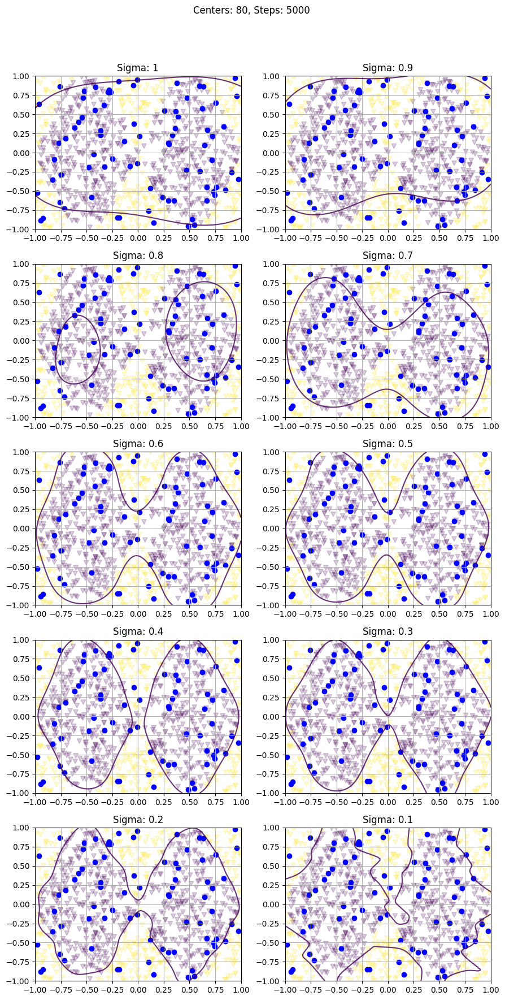

FIT TIME: 0.8911235332489014 s
ACC: 0.734
FIT TIME: 0.551659345626831 s
ACC: 0.721
FIT TIME: 0.5088074207305908 s
ACC: 0.485
FIT TIME: 0.49041128158569336 s
ACC: 0.712
FIT TIME: 0.5756738185882568 s
ACC: 0.697
FIT TIME: 0.5068280696868896 s
ACC: 0.828
FIT TIME: 0.49652719497680664 s
ACC: 0.927
FIT TIME: 0.6170425415039062 s
ACC: 0.939
FIT TIME: 0.5371983051300049 s
ACC: 0.853
FIT TIME: 0.5606904029846191 s
ACC: 0.895
Best params: [9.39e-01 1.00e+02 5.00e+02 3.00e-01]


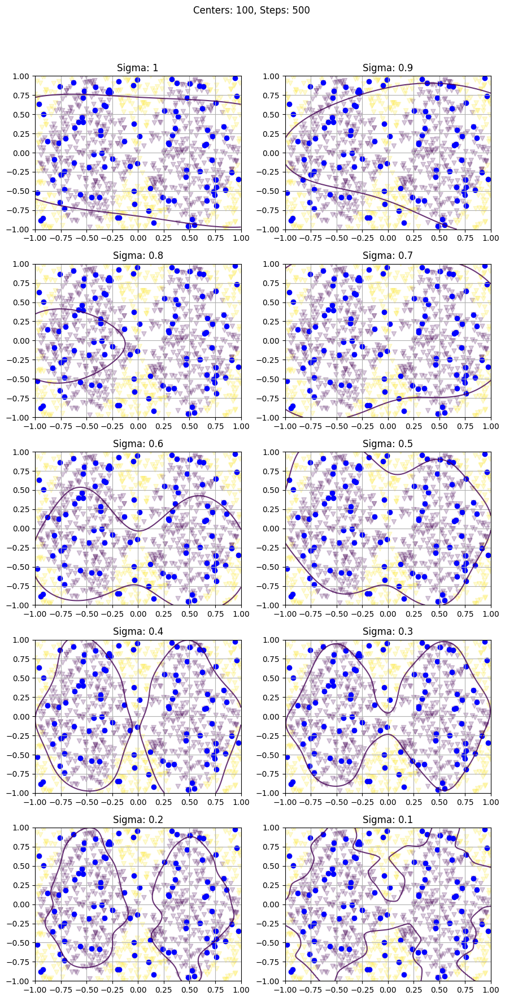

FIT TIME: 0.8190176486968994 s
ACC: 0.401
FIT TIME: 1.0891237258911133 s
ACC: 0.732
FIT TIME: 0.5888915061950684 s
ACC: 0.497
FIT TIME: 0.5926549434661865 s
ACC: 0.776
FIT TIME: 0.6324081420898438 s
ACC: 0.874
FIT TIME: 0.6948990821838379 s
ACC: 0.908
FIT TIME: 0.668079137802124 s
ACC: 0.948
FIT TIME: 0.5688827037811279 s
ACC: 0.943
FIT TIME: 0.58223557472229 s
ACC: 0.965
FIT TIME: 0.6198058128356934 s
ACC: 0.905
Best params: [9.65e-01 1.00e+02 1.50e+03 2.00e-01]


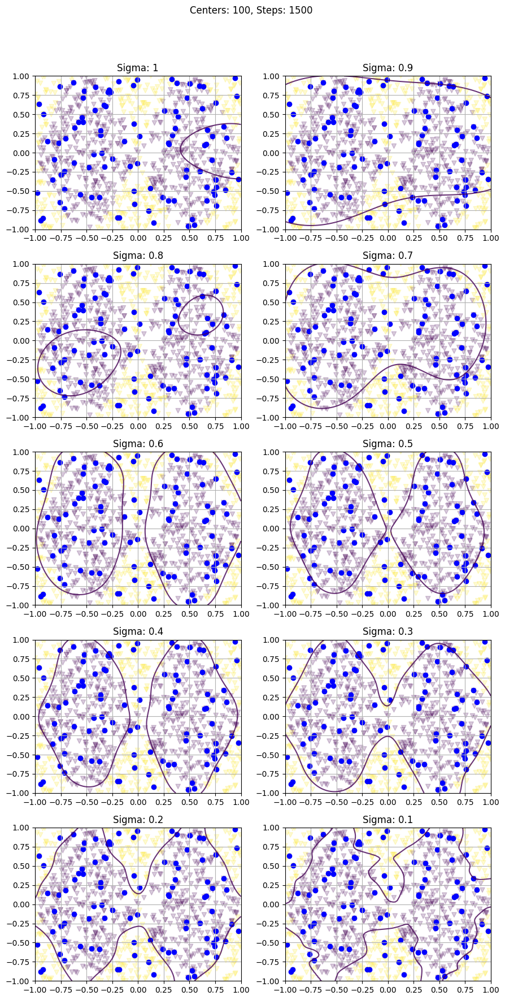

FIT TIME: 1.0606591701507568 s
ACC: 0.743
FIT TIME: 1.3881382942199707 s
ACC: 0.738
FIT TIME: 0.6771936416625977 s
ACC: 0.748
FIT TIME: 1.4234459400177002 s
ACC: 0.779
FIT TIME: 0.739222526550293 s
ACC: 0.905
FIT TIME: 1.0355615615844727 s
ACC: 0.933
FIT TIME: 0.7398040294647217 s
ACC: 0.962
FIT TIME: 1.3174362182617188 s
ACC: 0.956
FIT TIME: 0.6719882488250732 s
ACC: 0.965
FIT TIME: 1.4160494804382324 s
ACC: 0.925
Best params: [9.65e-01 1.00e+02 2.50e+03 2.00e-01]


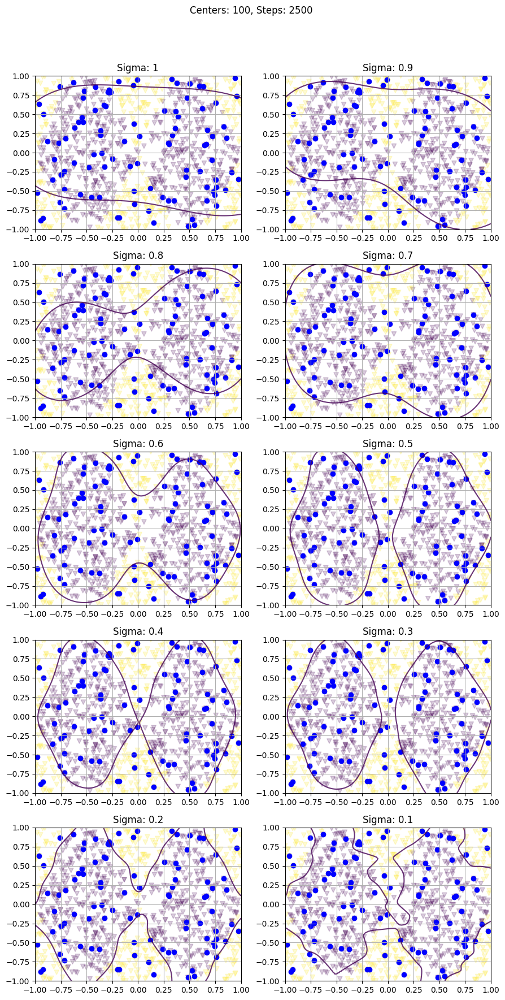

FIT TIME: 1.134854793548584 s
ACC: 0.711
FIT TIME: 0.7792394161224365 s
ACC: 0.703
FIT TIME: 0.852013349533081 s
ACC: 0.768
FIT TIME: 0.7916738986968994 s
ACC: 0.775
FIT TIME: 0.7982175350189209 s
ACC: 0.919
FIT TIME: 0.7641549110412598 s
ACC: 0.931
FIT TIME: 0.8281517028808594 s
ACC: 0.964
FIT TIME: 0.7883908748626709 s
ACC: 0.976
FIT TIME: 0.8050758838653564 s
ACC: 0.972
FIT TIME: 0.7707245349884033 s
ACC: 0.93
Best params: [9.76e-01 1.00e+02 3.50e+03 3.00e-01]


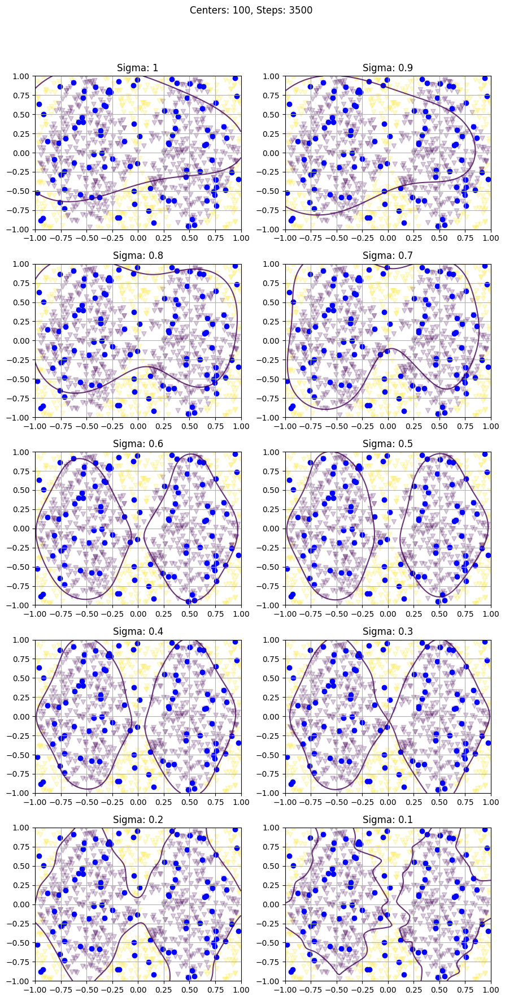

FIT TIME: 2.4810540676116943 s
ACC: 0.333
FIT TIME: 0.9347262382507324 s
ACC: 0.764
FIT TIME: 1.8450629711151123 s
ACC: 0.783
FIT TIME: 0.9317235946655273 s
ACC: 0.882
FIT TIME: 1.3037240505218506 s
ACC: 0.812
FIT TIME: 0.9055492877960205 s
ACC: 0.933
FIT TIME: 0.947584867477417 s
ACC: 0.964
FIT TIME: 0.9446783065795898 s
ACC: 0.973
FIT TIME: 0.9604101181030273 s
ACC: 0.973
FIT TIME: 0.9186618328094482 s
ACC: 0.943
Best params: [9.73e-01 1.00e+02 5.00e+03 3.00e-01]


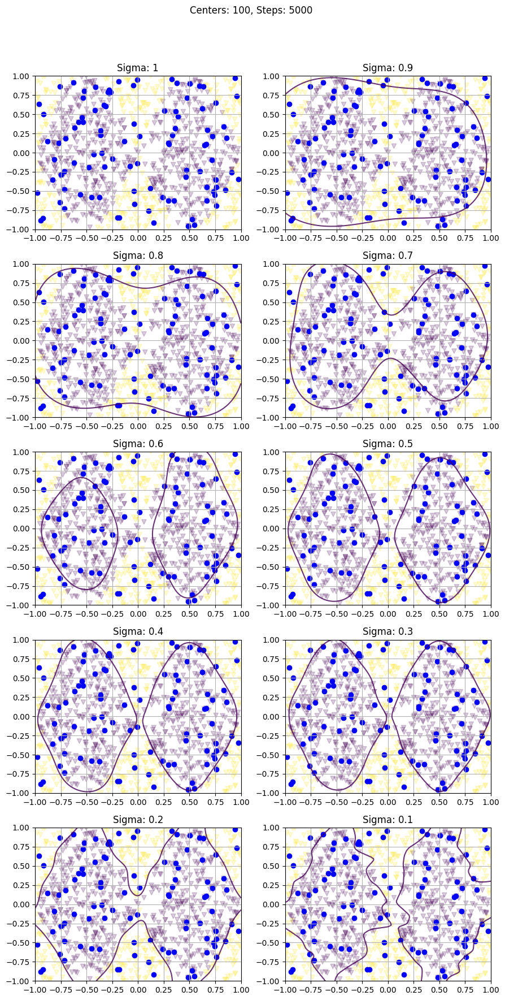

<ipython-input-5-c522f605a088>:106: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 1, 0.95])


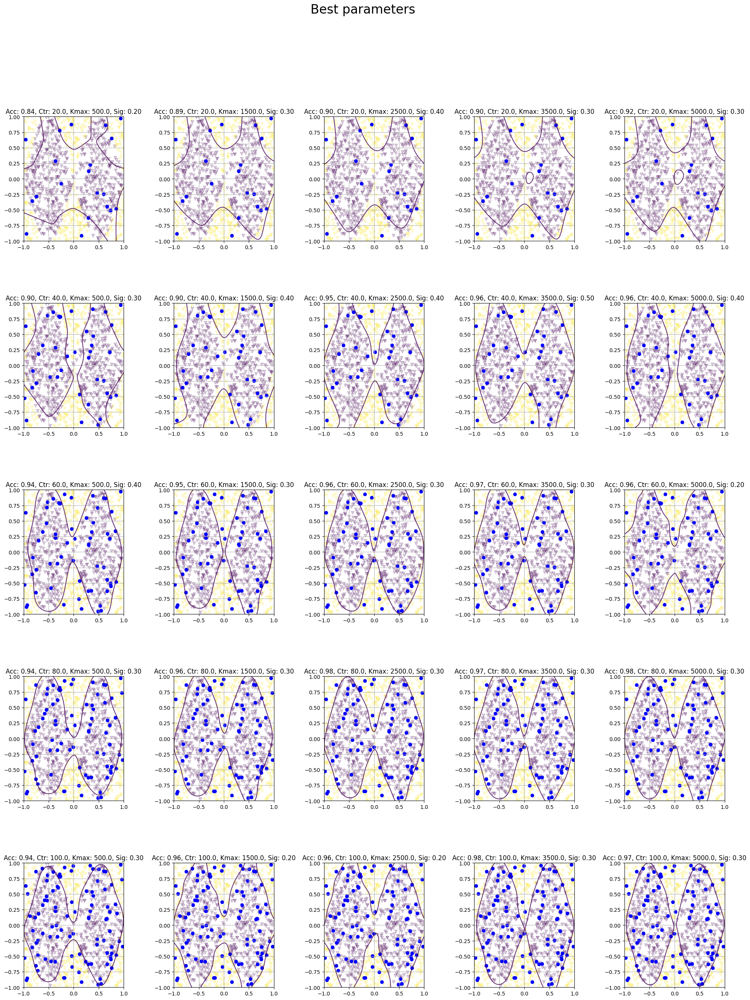

In [ ]:
X, y = data_sinus(m=1000)
plt.scatter(X[:, 0], X[:, 1], c=y)
plt.show()


clf = SimplePerceptron(learning_rate=1.0)
#np.random.seed(0)
k_centers = [20, 40, 60, 80, 100]
k_maxes = [500, 1500, 2500, 3500, 5000]
sigma_values = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]

best_parameters = np.zeros((len(k_centers) * len(k_maxes), 4))

for idx_center, k_center in enumerate(k_centers):
    for id_accs, k_value in enumerate(k_maxes):
        fig, axs = plt.subplots(5, 2, figsize=(9, 18))
        fig.suptitle(f"Centers: {k_center}, Steps: {k_value}")


        best_acc = np.zeros((1, 4))
        for idx, s_value in enumerate(sigma_values):

            t1 = time.time()
            X_ndim, centers = clf.fit(X, y, k_centers=k_center, k_max=k_value, non_linear=True, use_sigma=True, sigma_value=s_value)
            t2 = time.time()

            print(f"FIT TIME: {t2 - t1} s")
            curr_acc = clf.score(X, y)
            print(f"ACC: {curr_acc}")

            if curr_acc > best_acc[0, 0]:
              best_acc[0, :] = [ curr_acc, k_center, k_value, s_value ]

            x_coords = np.linspace(-1, 1, 100)
            y_coords = np.linspace(-1, 1, 100)
            x1, x2 = np.meshgrid(x_coords, y_coords)

            x1_flat = x1.ravel()
            x2_flat = x2.ravel()
            coordinates2d = np.column_stack((x1_flat, x2_flat))

            labels = clf.decision_function(coordinates2d)

            labels = np.reshape(labels, (100,100))

            ax = axs[idx // 2, idx % 2]
            ax.contour(x1, x2, labels, alpha=0.8, levels=[0])
            ax.scatter(X[:, 0], X[:, 1], alpha=0.2, c=y, marker="v")
            ax.scatter(centers[:, 0], centers[:, 1], color='b')
            ax.set_title(f"Sigma: {s_value}")
            ax.set_xlim(-1, 1)
            ax.set_ylim(-1, 1)
            ax.grid()

        best_parameters[len(k_centers) *idx_center + id_accs, :] = best_acc
        print(f"Best params: {best_parameters[(len(k_centers) *idx_center + id_accs), :]}" )

        plt.tight_layout(rect=[0, 0, 1, 0.95])
        plt.show()

##wyświetlanie najlepszych rezultatów
fig = plt.figure(figsize=(24, 30))
fig.suptitle("Best parameters", fontsize=24)


spec = gridspec.GridSpec(5, 5, figure=fig, hspace=0.5, wspace=0.5)  # hspace i wspace kontrolują odstępy

for idx, params in enumerate(best_parameters):
    if idx >= 25:
        break

    X_ndim, centers = clf.fit(X, y, k_centers=int(params[1]), k_max=int(params[2]), non_linear=True, use_sigma=True, sigma_value=params[3])
    x_coords = np.linspace(-1, 1, 100)
    y_coords = np.linspace(-1, 1, 100)
    x1, x2 = np.meshgrid(x_coords, y_coords)

    x1_flat = x1.ravel()
    x2_flat = x2.ravel()
    coordinates2d = np.column_stack((x1_flat, x2_flat))
    labels = clf.decision_function(coordinates2d)
    labels = np.reshape(labels, (100,100))


    ax = fig.add_subplot(spec[idx])
    ax.contour(x1, x2, labels, alpha=0.8, levels=[0])
    ax.scatter(X[:, 0], X[:, 1], alpha=0.2, c=y, marker="v")
    ax.scatter(centers[:, 0], centers[:, 1], color='b')
    ax.set_title(
        f"Acc: {params[0]:.2f}, Ctr: {params[1]}, Kmax: {params[2]}, Sig: {params[3]:.2f}",
        fontsize=12
    )
    ax.set_xlim(-1, 1)
    ax.set_ylim(-1, 1)
    ax.grid()

plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()